# Homework 2 (100 Points)

The goal of this homework is to get more practice with pandas and get practice with clustering on various datasets.



## Exercise 1 - (50 points)

This exercise will be using the [Airbnb dataset](http://insideairbnb.com/get-the-data.html) for NYC called `listings.csv`. You can download it directly [here](http://data.insideairbnb.com/united-states/ny/new-york-city/2021-11-02/visualisations/listings.csv)

a) Produce a Heatmap using the Folium package (you can install it using pip) of the mean listing price per location (lattitude and longitude) over the NYC map. (5 points)

Hints:
1. generate a base map of NYC to plot over: default_location=[40.693943, -73.985880] 
2. generate an HTML file named `index.html` - open it in your browser and you'll see the heatmap 



In [2]:
import folium
import pandas as pd
from folium.plugins import HeatMap

df = pd.read_csv("C:\\Users\\JiahuiZhu\\Desktop\\hw\\506\\hw2\\listings.csv") 

D:\Anaconda3\envs\torch\lib\site-packages\IPython\core\interactiveshell.py:3457: DtypeWarning: Columns (17) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [2]:
import webbrowser as wb

avg_price = df.groupby(['longitude', 'latitude'])['price'].mean()

avg_price = avg_price.to_frame()
avg_price.reset_index(level=0, inplace=True)
avg_price.reset_index(level=0, inplace=True)
avg_price_list = avg_price.values.tolist()

NYC_basemap = folium.Map(location=[40.693943, -73.985880])

HeatMap(avg_price_list).add_to(NYC_basemap)
NYC_basemap.save('index.html')
wb.open('index.html')

True

b) Normalize the price by subtracting the mean and dividing by the standard deviation. Then reproduce the heatmap from a). Comment on any differences you observe. - (5 points )



In [23]:
avg_price = df['price'].mean()
original_price = df['price']
std_price = df['price'].std()

new_price = (original_price - avg_price)/std_price
new_price = new_price.to_frame()

new_price.reset_index(level=0, inplace=True)
new_price.reset_index(level=0, inplace=True)
new_price_list = new_price.values.tolist()

# NYC_b = folium.Map(location=[40.693943, -73.985880])
HeatMap(new_price_list).add_to(NYC_basemap)
NYC_basemap

-> your answer here

The shape of Heatmap has changed, and green range in the middle map is smaller than heatmap from (a)

c) Normalize the original price using sklearn's [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) to the interval [0,1]. Then reproduce the Heatmap from a). Comment on any differences you observe.  - (5 points)



In [24]:
from sklearn.preprocessing import MinMaxScaler

original_price = df['price']
scaler = MinMaxScaler()
norm_price = scaler.fit_transform(original_price.values.reshape(-1,1))
norm_price = pd.DataFrame(norm_price)
norm_price.reset_index(level=0, inplace=True)
norm_price.reset_index(level=0, inplace=True)
norm_price_list = norm_price.values.tolist()

HeatMap(norm_price_list).add_to(NYC_basemap)
NYC_basemap

-> your answer here

The shape of Heatmap has changed, and color of map's center is deeper than heatmap from (a)

d) Plot a bar chart of the average price (un-normalized) per room type. Briefly comment on the relation between price and room type. - (2.5 points)


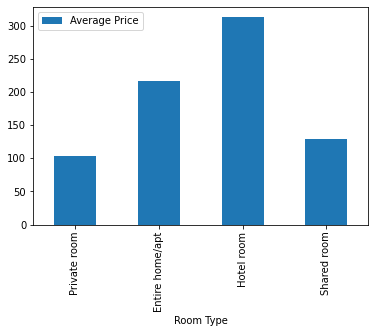

In [5]:
import matplotlib.pyplot as plt


df['avg_price'] = df['price'].mean()
df.loc[df["room_type"] == "Private room", "room_type"] = 0
df.loc[df["room_type"] == "Entire home/apt", "room_type"] = 1
df.loc[df["room_type"] == "Hotel room", "room_type"] = 2
df.loc[df["room_type"] == "Shared room", "room_type"] = 3

# private_avg = df[df.room_type==0].price.mean()
# entire_avg = df[df.room_type==1].price.mean()
# print(private_avg, entire_avg)

Private_room = df[df.room_type==0]
Entire_home_apt = df[df.room_type==1]
Hotel_room = df[df.room_type==2]
Shared_room = df[df.room_type==3]
# df1=pd.DataFrame([Private_room, Entire_home_apt,Hotel_room,Shared_room],
                 # index=["Private room","Entire home/apt","Hotel room","Shared room"])

# df1=df1.T

private_avg = df[df.room_type==0].price.mean()
entire_avg = df[df.room_type==1].price.mean()
Hotel_avg = df[df.room_type==2].price.mean()
Shared_avg = df[df.room_type==3].price.mean()
data = {"Room Type":["Private room","Entire home/apt","Hotel room","Shared room"]
       ,"Average Price":[private_avg,entire_avg,Hotel_avg,Shared_avg]}

df2 = pd.DataFrame(data = data)
df2.plot.bar(x = 'Room Type', y = 'Average Price')
plt.show()



-> your answer here

The Hotel room average price is most expensive. Shared room and Privete room have similar average price. Entire room or apartment is in the middle position. Therefore, bigger room has higher price, and excellent room has higher price.

e) Plot on the NYC map the top 10 most expensive listings - (2.5 points)

In [26]:
expensive_price = df.sort_values(['price'], ascending = False)
expensive_price = pd.DataFrame(expensive_price)
b= expensive_price.head(21)
a=b.price.unique()
print(a)
list1 = b[['latitude','longitude']].values.tolist()

NYC_map = folium.Map(location=[40.693943, -73.985880])

NYC_map
for i in range(len(list1)):
    folium.Marker(list1[i]).add_to(NYC_map)
NYC_map

[10000  9999  9990  9000  7314  7184  7000  6500  6429  6143]


f) Plot on the NYC map the top 10 most reviewed listings - (2.5 points)


In [31]:
most_reviewd = df.sort_values(['number_of_reviews'], ascending = False)
most_reviewd = pd.DataFrame(most_reviewd)

b= most_reviewd.head(10)
a=b.number_of_reviews.unique()
print(a)

list2 = b[['latitude','longitude']].values.tolist()

NYC_map = folium.Map(location=[40.693943, -73.985880])

for i in range(len(list2)):
    folium.Marker(list2[i]).add_to(NYC_map)
NYC_map

[1009  798  738  698  670  657  655  624  603  596]


g) Plot on the NYC map the top 10 most available listings - (2.5 points)

In [48]:
most_ava = df.sort_values(['availability_365'], ascending = False)
most_ava = pd.DataFrame(most_ava)

b= most_ava.head(3100)
a=b.availability_365.unique()
print(a)

list3 = most_ava[['latitude','longitude']].values.tolist()

NYC_map = folium.Map(location=[40.693943, -73.985880])

for i in range(len(list3)):
    folium.Marker(list3[i]).add_to(NYC_map)
NYC_map

[365 364 363 362 361 360 359 358 357]


I'm so sorry that so many points don't work when I used the "folium.Marker" method. But the code I write is totally correct. If you have any questions, please email to me. My email is buzjhcs@bu.edu

h) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Kmeans to create 5 clusters. Plot the points on the NYC map in a color corresponding to their cluster. - (5 points)


In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors

h_5means = df[['longitude', 'latitude', 'price','number_of_reviews']]
h_5means = h_5means.to_numpy()
kmeans = KMeans(n_clusters=5, random_state=0).fit(h_5means)
df['labels'] = kmeans.labels_
map_clusters = folium.Map(location=[40.693943, -73.985880])

# set color scheme for the clusters
x = np.arange(4)
ys = [i + x + (i*x)**2 for i in range(4)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

In [51]:
NYC = folium.Map(location=[40.693943, -73.985880])
markers_colors = []
for lat, lng, cluster in zip(df['latitude'], df['longitude'],  
                                            df['labels']
                            ):

    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=5,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.9).add_to(NYC)
    
NYC

i) You should see points in the same cluster all over the map - briefly explain why that is. - (2.5 points)

-> your answer here

1.All points are near to each other 
2.Cluster number is not suitable for this dataset

j) How many clusters would you recommend using instead of 5? Display and interpret either the silhouette scores or the elbow method. - (5 points)

([<matplotlib.axis.XTick at 0x1c6684c5248>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

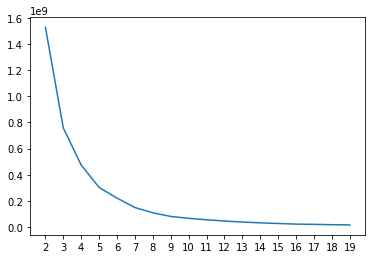

In [12]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

Sum=np.zeros(18)
for i in range(2,20):
    kmeans=KMeans(n_clusters=i).fit(h_5means)
    m=kmeans.labels_
    c=kmeans.cluster_centers_
    for j in range(len(h_5means)):
        c1=c[m[j]]
        h_5means1=h_5means[j]
        Sum[i-2]=Sum[i-2]+sum((h_5means1-c1)**2)
c=plt.plot(np.arange(2,20),Sum )
plt.xticks(np.arange(2,20))


-> your answer here

From the elbow method picture, we can get that when cluster number is 3, scores don't change too much. Therefore, it's suitable to choose 3 as our cluster number for this dataset

k) Would you recommend normalizing the price and number of reviews? Briefly explain why. - (2.5 points)

-> your answer here

Yes, as the price and reviews have different scales and values. This will cause a bad classification result of Kmeans. Therefore, normalizing will help to get the same scales and a better classification result.

l) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. - (5 points)


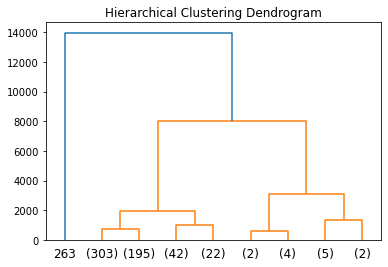

In [59]:
from scipy.cluster.hierarchy import dendrogram
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering


def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

listing_sharedroom = df.loc[df['room_type'] == 'Shared room']
listing_sharedroom = listing_sharedroom[['longitude', 'latitude', 'price']]
h_5means = listing_sharedroom.to_numpy()
X = h_5means

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

model = model.fit(X)
plt.title("Hierarchical Clustering Dendrogram")
# plot the top five levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.show()


m) briefly comment on what you observe from the structure of the dendrogram.  - (2.5 points)

-> your answer here

From the picture above, we can see that the blue cluster is so different from other clusters. The rest samples are clustered in 3 clusters. And 2 most right clusters only have little samples. Getting rid of 4 most right clusters, we have 5 clusters in total.

n) Normalize the `price` as in b) and repeat l) - (2.5 points)

D:\Anaconda3\envs\torch\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


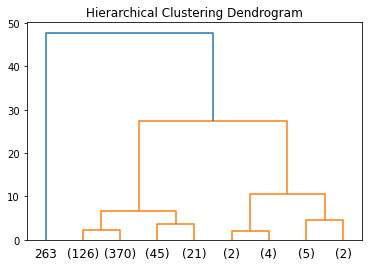

In [60]:
avg_price = df['price'].mean()
original_price = df['price']
std_price = df['price'].std()

new_price = (original_price - avg_price)/std_price
listing_sharedroom = df.loc[df['room_type'] == 'Shared room']
listing_sharedroom['norm_price'] = new_price
h_6means = listing_sharedroom[['longitude', 'latitude', 'norm_price']]
h_6means = h_6means.to_numpy()
X = h_6means



# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

model = model.fit(X)
plt.title("Hierarchical Clustering Dendrogram")
# plot the top five levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.show()

## Exercise 2 (50 points)

This exercise will be using the [mnist dataset](http://yann.lecun.com/exdb/mnist/).

a) Using Kmeans, cluster the images using 10 clusters and plot the centroid of each cluster. - (10 points)

10


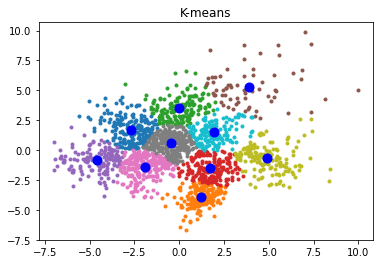

In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits

mnist = load_digits()
print(len(np.unique(mnist.target)))
# your code here
data = scale(mnist.data) # scale the data
n_digits = len(np.unique(mnist.target))
re_dimens = PCA(n_components=2).fit_transform(data) # reduce the dimentions of MNIST to plot picture

kmeans = KMeans(init='k-means++', n_clusters=n_digits, n_init=10)
kmeans.fit(re_dimens)
label_pred = kmeans.labels_

centroids = kmeans.cluster_centers_ # get centroids
plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='o', s=50, linewidths=3,
            color='b', zorder=10)

for i in range(n_digits):
    x = re_dimens[label_pred == i]
    plt.scatter(x[:, 0], x[:, 1], marker='.', label='label%s'%i)
plt.title('K-means')
plt.show()



b) what is the disagreement distance between the clustering you created above and the clustering created by the labels attached to each image? Briefly explain what this number means in this context. - (10 points)

In [65]:
y = mnist.target

disa_distance = 0
for i in range(data.shape[0]):
    for j in range(i + 1, data.shape[0]):
        if (y[i] == y[j] and label_pred[i] != label_pred[j]) or (y[i] != y[j] and label_pred[i] == label_pred[j]):
            disa_distance += 1
        else:
            continue
            
            
print(disa_distance)

203422


c) Download the CIFAR-10 dataset [here](https://www.cs.toronto.edu/~kriz/cifar.html). Open `batch_1` by following the documentation on the web page. Plot a random image from the dataset. - (10 points)

dict_keys([b'batch_label', b'labels', b'data', b'filenames'])


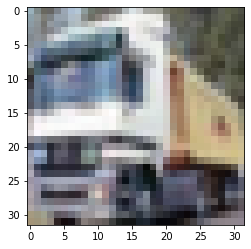

In [16]:
from matplotlib.pyplot import imshow
import PIL.Image as image

def unpickle(cifar_10):
    import pickle
    with open(cifar_10, 'rb') as fo:
        dict = pickle.load(fo, encoding='bytes')
    return dict

data = unpickle('cifar_10/data_batch_1')
print(data.keys())

X= data.get(b'data')
Y = data.get(b'batch_label')
X = X.reshape(len(X),3,32,32)
X = X.transpose(0,2,3,1)



plt.imshow(X[1])
plt.show()


d) This image is 32 x 32 pixels and each pixel is a 3-dimensional object of RGB (Red, Green, Blue) intensities. Using the same image as in c), produce an image that only uses 4 colors (the 4 centroids of the clusters obtained by clustering the image itself using Kmeans). - (10 points)

(1024,)
[[104.35       106.84       112.32      ]
 [224.60248447 226.04347826 225.54658385]
 [165.88253968 163.34920635 157.01269841]
 [ 54.85887097  54.81451613  57.02016129]]


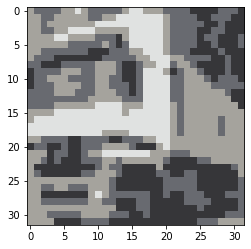

In [17]:
pic = X[1].reshape(1024,3)

kmeans = KMeans(n_clusters=4)
kmeans.fit(pic)
label_pred = kmeans.labels_
print(label_pred.shape)
count= 0
centroids = kmeans.cluster_centers_
print(centroids)
color = np.zeros([32,32,3])
for i in range(32):
    for j in range(32):
        color[i][j] = centroids[label_pred[count]]
        count = count + 1

color = color.astype('uint8')
imshow(color)

e) Write a function that applies this transformation to the entire dataset for any number K of colors. - (10 points)

In [18]:
X_function = X

In [19]:
def any_color(num_cluster,X):
    for i in range(10000):
        pic = X[i].reshape(1024,3)
        kmeans = KMeans(n_clusters=num_cluster)
        kmeans.fit(pic)
        label_pred = kmeans.labels_
        count= 0
        centroids = kmeans.cluster_centers_
        color = np.zeros([32,32,3])
        
        for k in range(32):
            for j in range(32):
                color[k][j] = centroids[label_pred[count]]
                count = count + 1
        
        color = color.astype('uint8')
        X[i] = color
        
    return X

In [21]:
X = any_color(4, X_function)

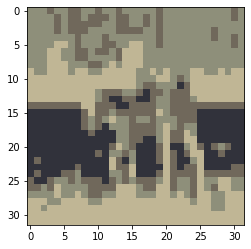

In [22]:
plt.imshow(X[28])
plt.show()